In [5]:
%reset

Once deleted, variables cannot be recovered. Proceed (y/[n])? y


In [6]:
%matplotlib inline

In [13]:
import numpy as np
import scipy.io as sio
import netCDF4 as nc
import glob, os
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import matplotlib
import cmocean
matplotlib.rcParams['animation.embed_limit'] =10000000000000000000000000.0

In [9]:
%cd /work/eay/MITgcm_data/Experiment32
file1 = nc.Dataset('Salt.nc')
file2 = nc.Dataset('U.nc')
file3 = nc.Dataset('V.nc')
NX = 600
NY = 1000
NZ = 120

xq = (file1.variables['X'][:])
yq = (file1.variables['Y'][:])
zl = (file1.variables['Z'][:])
Time = file1.variables['T'][:]
print(Time.shape)

xqmat=np.tile(xq,(NY,1))
yqmat=np.tile(yq,(NX,1))
yqmat=np.transpose(yqmat)
print(yqmat.shape)
print(xqmat.shape)
%cd /work/eay/MITgcm_data/

/work0/eay/MITgcm_data/Experiment32
(150,)
(1000, 600)
(1000, 600)
/work0/eay/MITgcm_data


In [10]:
mask = file1.variables['S'][30,0,:,:]
mask.shape

(1000, 600)

Text(0.5, 1.0, '(psu)')

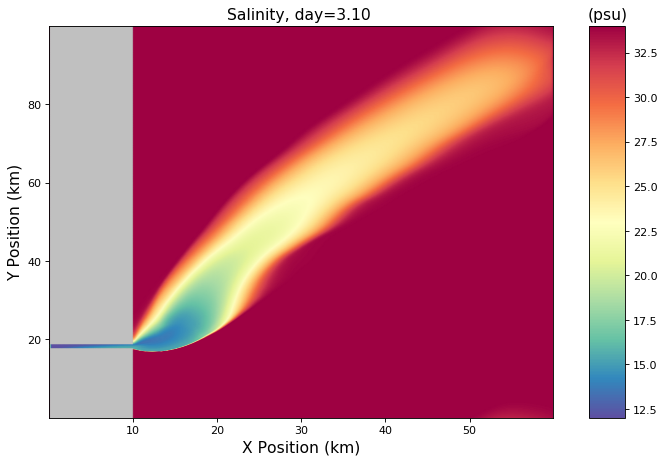

In [11]:
#Plotting surface salinity
Salt = file1.variables['S'][149,0,:,:]
fig = plt.figure(figsize=(9, 7), dpi= 80, facecolor='w', edgecolor='k')
ax1 = fig.add_axes([0.15,0.1,0.7,0.7])  #left pos. bottom pos. width, height #ax1 = fig.add_subplot(111)
ax2 = fig.add_axes([.9, 0.1, 0.05, 0.7])


quad1 = ax1.pcolormesh(xq/1000,yq/1000,Salt,cmap='Spectral_r',vmin=12.,vmax=34.,shading='gouraud')
quad1.cmap.set_under('silver')
#ax1.set_xlim(0,30)
ax1.set_title('Salinity, day=%04.2f ' %(149/48.), fontsize=14)
ax1.set_facecolor((0.92, 0.92, 0.92))
ax1.set_xlabel('X Position (km)',fontsize=14)
ax1.set_ylabel('Y Position (km)',fontsize=14)
cb1 = fig.colorbar(quad1,ax2)
plt.title('(psu)', fontsize=14)

In [12]:
def init():
    quad1.set_array([])
    ax1.set_title([])
    return quad1
def animate(iter):    
    #z = file1.variables['e'][iter,1:121,450,:]
    if 0 <= iter <= 149:
            Salt=file1.variables['S'][iter,0,:,:]
    quad1.set_array(Salt.ravel())
    ax1.set_title('Salinity, day=%04.2f ' %(iter/48.), fontsize=14)
    return quad1
print('done')

done


In [13]:
anim = animation.FuncAnimation(fig,animate,frames=150,interval=100,blit=False,repeat=False)
print('done')

done


In [14]:
HTML(anim.to_jshtml())

In [15]:
anim.save('VideoSalt.gif', writer='imagemagick')
#cp Videotest.gif /home/eay/  for scp-ing from my local computer!
#scp public:/home/eay/Videotest.gif .
#matplotlib.rcParams['animation.embed_limit'] =40.0

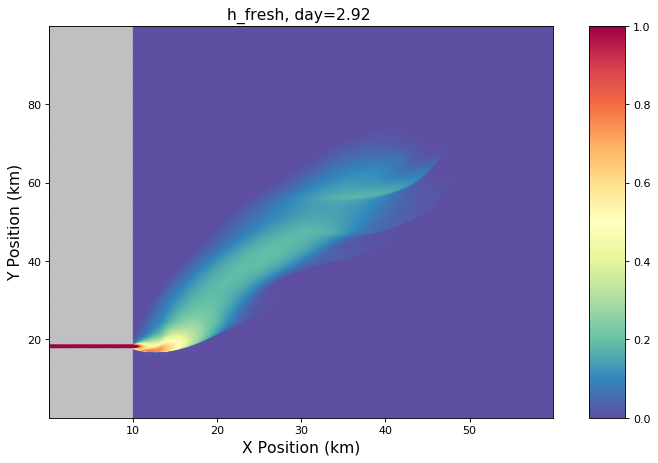

In [16]:
#Plotting freshwater layer
newmask = file1.variables['S'][109,:,:,:]

Salt = file1.variables['S'][109,:,:,:]; Salt[newmask==0]=np.nan
Sref = Salt*0.0+34.0
hf=0.1*np.nansum((Sref-Salt)/34.0,axis=0)
hf[(mask==0)]=-10000000
###hf(i,j)=0.1*sum((sr-s(i,j,:))/sr); (your delta z is 0.1 correct?)###

fig = plt.figure(figsize=(9, 7), dpi= 80, facecolor='w', edgecolor='k')
ax1 = fig.add_axes([0.15,0.1,0.7,0.7])  #left pos. bottom pos. width, height #ax1 = fig.add_subplot(111)
ax2 = fig.add_axes([.9, 0.1, 0.05, 0.7])


quad1 = ax1.pcolormesh(xq/1000,yq/1000,hf,cmap='Spectral_r',shading='gouraud',vmin=0,vmax=1)
quad1.cmap.set_under('silver')
#ax1.set_xlim(0,30)
ax1.set_title('h_fresh, day=%04.2f ' %(140/48.), fontsize=14)
ax1.set_facecolor((0.92, 0.92, 0.92))
ax1.set_xlabel('X Position (km)',fontsize=14)
ax1.set_ylabel('Y Position (km)',fontsize=14)
cb1 = fig.colorbar(quad1,ax2)

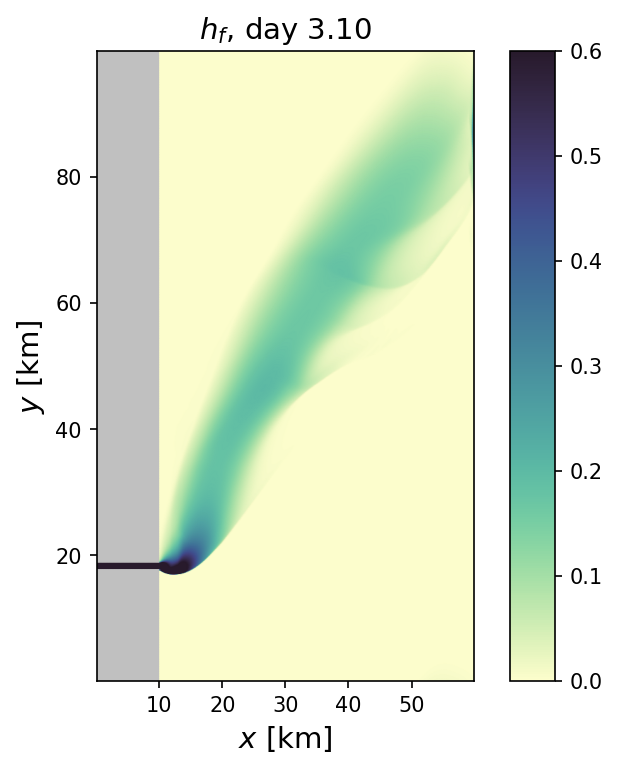

In [33]:
#Plotting freshwater layer
newmask = file1.variables['S'][0,:,:,:]

index=149
Salt = file1.variables['S'][index,:,:,:]; Salt[newmask==0]=np.nan
Sref = Salt*0.0+34.0
hf=0.1*np.nansum((Sref-Salt)/34.0,axis=0)
hf[(mask==0)]=-10000000
###hf(i,j)=0.1*sum((sr-s(i,j,:))/sr); (your delta z is 0.1 correct?)###

fig = plt.figure(figsize=(6, 6), dpi= 150, facecolor='w', edgecolor='k')
ax1 = fig.add_axes([0.15,0.1,0.7,0.7])  #left pos. bottom pos. width, height #ax1 = fig.add_subplot(111)
ax2 = fig.add_axes([.75, 0.1, 0.05, 0.7])


quad1 = ax1.pcolormesh(xq/1000,yq/1000,hf,cmap=cmocean.cm.deep,shading='gouraud',vmin=0,vmax=.6)
quad1.cmap.set_under('silver')
quad1.cmap.set_over(quad1.cmap(1.))

#ax1.set_xlim(0,30)
ax1.set_title('$h_f$, day %04.2f' %(index/48.), fontsize=14)
ax1.set_aspect('equal')
ax1.set_facecolor((0.92, 0.92, 0.92))
ax1.set_xlabel('$x$ [km]',fontsize=14)
ax1.set_ylabel('$y$ [km]',fontsize=14)

cb1 = fig.colorbar(quad1,ax2)
#plt.title('(m)', fontsize=14)

In [37]:
def init():
    quad1.set_array([])
    ax1.set_title([])
    return quad1
def animate(iter):    
    #z = file1.variables['e'][iter,1:121,450,:]
    if 0 <= iter <= 149:
            Salt = file1.variables['S'][iter,:,:,:];  Salt[newmask==0]=np.nan
            hf   = 0.1*np.nansum((Sref-Salt)/34.0,axis=0)
            hf[(mask==0)]=-10000000
    quad1.set_array(hf.ravel())
    ax1.set_title('$h_f$, day=%04.2f ' %(iter/48.), fontsize=14)
    return quad1
print('done')

done


In [38]:
anim = animation.FuncAnimation(fig,animate,frames=150,interval=100,blit=False,repeat=False)
print('done')

done


In [39]:
HTML(anim.to_jshtml())

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/nbhome/eay/anaconda3/lib/python3.7/site-packages/numpy/ma/core.py", line 1158, in __call__
    result = self.f(da, db, *args, **kwargs)
KeyboardInterrupt

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/nbhome/eay/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-39-3115c674a9d7>", line 1, in <module>
    HTML(anim.to_jshtml())
  File "/nbhome/eay/anaconda3/lib/python3.7/site-packages/matplotlib/animation.py", line 1380, in to_jshtml
    self.save(str(path), writer=writer)
  File "/nbhome/eay/anaconda3/lib/python3.7/site-packages/matplotlib/animation.py", line 1139, in save
    anim._init_draw()
  File "/nbhome/eay/anaconda3/lib/python3.7/site-packages/matplotlib/animation.py", line 1732, in _init_draw
    self._draw_frame(next(self.new_frame_seq()))
  File 

TypeError: can only concatenate str (not "list") to str

In [40]:
anim.save('Videofresh.gif', writer='imagemagick')
#cp Videotest.gif /home/eay/  for scp-ing from my local computer!
#scp public:/home/eay/Videotest.gif .
#matplotlib.rcParams['animation.embed_limit'] =40.0

Text(0.5, 1.0, '(m/s)')

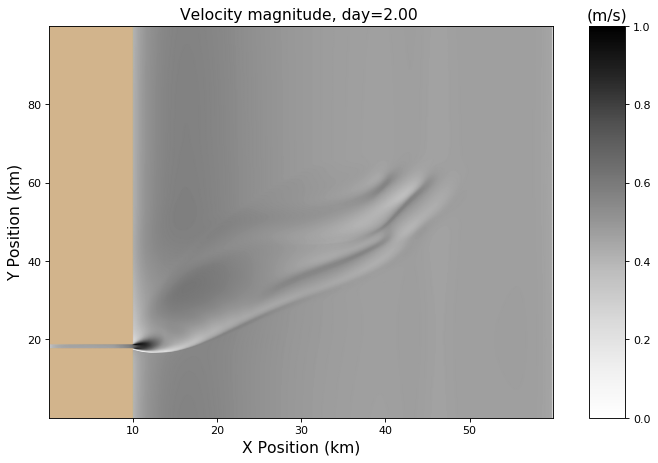

In [26]:
#PLOTTING Offshore Velocity
U = (file2.variables['U'][96,0,:,1:]+file2.variables['U'][96,0,:,:-1])/2
V = (file3.variables['V'][96,0,1:,:]+file3.variables['V'][96,0,:-1,:])/2
velocity = np.sqrt(U**2+V**2)
velocity[(mask==0)]=-10000000
fig = plt.figure(figsize=(9, 7), dpi= 80, facecolor='w', edgecolor='k')
ax1 = fig.add_axes([0.15,0.1,0.7,0.7])  #left pos. bottom pos. width, height #ax1 = fig.add_subplot(111)
ax2 = fig.add_axes([.9, 0.1, 0.05, 0.7])


quad1 = ax1.pcolormesh(xq/1000,yq/1000,velocity,cmap='Greys',vmin=0.,vmax=1,shading='gouraud')
quad1.cmap.set_under('tan')
#ax1.set_xlim(0,30)
ax1.set_title('Velocity magnitude, day=%04.2f ' %(96/48.), fontsize=14)
ax1.set_facecolor((0.92, 0.92, 0.92))
ax1.set_xlabel('X Position (km)',fontsize=14)
ax1.set_ylabel('Y Position (km)',fontsize=14)
cb1 = fig.colorbar(quad1,ax2)
plt.title('(m/s)', fontsize=14)

In [27]:
def init():
    quad1.set_array([])
    ax1.set_title([])
    return quad1
def animate(iter):    
    #z = file1.variables['e'][iter,1:121,450,:]
    if 0 <= iter <= 149:
            U = (file2.variables['U'][iter,0,:,1:]+file2.variables['U'][iter,0,:,:-1])/2
            V = (file3.variables['V'][iter,0,1:,:]+file3.variables['V'][iter,0,:-1,:])/2
            velocity = np.sqrt(U**2+V**2)
            velocity[(mask==0)]=-10000000
    quad1.set_array(velocity.ravel())
    ax1.set_title('Velocity magnitude, day=%04.2f ' %(iter/48.), fontsize=14)
    return quad1
print('done')

done


In [28]:
anim = animation.FuncAnimation(fig,animate,frames=150,interval=100,blit=False,repeat=False)
print('done')

done


In [24]:
HTML(anim.to_jshtml())

In [29]:
anim.save('VideoVelocity.gif', writer='imagemagick')

In [30]:
np.min(velocity)

-10000000.0